In [3]:
import json
import re
import numpy as np
import ast
import torch
from sklearn.model_selection import train_test_split
from typing import List, Dict
from collections import defaultdict
from fuzzywuzzy import process
from nltk.util import ngrams
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter
from datasets import load_dataset, DatasetDict, Dataset
from transformers import AutoTokenizer, AutoModelForTokenClassification, Trainer, TrainingArguments

# Data Cleaning and Data Prepossesing

The primary purpose of this notebook is for preliminary data cleaning and data inspection, as the dataset is very raw from the first glance. 

### Step 1. Data Inspection and Preliminary Preprocessing

We begin by loading the dataset from [Huggingface](https://huggingface.co/datasets/devlocalhost/prescription-full/viewer/default/train). The 'results' field of the original dataset is in a string format, so we have to turn it into a dictionary.

In [7]:
ds = load_dataset("devlocalhost/prescription-full")
dataset = ds["train"]
dictionized_dataset = []
for row in ds['train']:
    text = row['text']
    results = ast.literal_eval(row['results'])
    newrow = {'text': text, 'results': results}
    dictionized_dataset.append(newrow)

For the purpose of this project, we only care about the information inside 'medicine_details' that is nested inside 'results'

In [8]:
dictionized_dataset[1]['results']['medicine_details']

[{'medicine_name': 'EBAST M TAB',
  'medicine_dosage': '0-0-1',
  'medicine_frequency': 'After Food',
  'course_duration': '15 Days'},
 {'medicine_name': 'AZEE 500MG TAB',
  'medicine_dosage': '1-0-1',
  'medicine_frequency': 'After Food',
  'course_duration': '5 Days'},
 {'medicine_name': 'VOLTOP DSR TAB',
  'medicine_dosage': '1-0-1',
  'medicine_frequency': 'Before Food',
  'course_duration': '5 Days'},
 {'medicine_name': 'ASCORIL D PLUS SYP',
  'medicine_dosage': '1-1-1',
  'medicine_frequency': 'After Food',
  'course_duration': '5 Days'}]

Some major data impurity are as follows:
- Some rows do not have 'medicine_details'
- Some rows, with 'medicine_details', do not have 'medicine_name'
- Some rows have 'medicine_name' == 'NA' (There are more than 20000 of them!)
- Some rows, even though have valid 'medicine_name', contains typo in its original 'text'(prescription) such that we cannot locate the 'medicine_name' inside the text. 

While we have a simple solution for the first three problems (drop those rows as it is very hard to impute these missing values without extra information), we will try to correct the typos using some techniques for the last problem.

#### **Dataset 1**: Drop all invalid rows (Medicine Name Only)

In [9]:
rows_with_med = []
for row in dictionized_dataset:
    if 'medicine_details' in row['results']:
        medicine_details = row['results']['medicine_details']
        if len(medicine_details) > 0:
            row['medicine_details'] = row['results']['medicine_details']
            row['medicine_names'] = [medicine['medicine_name'] for medicine in medicine_details 
                                     if 'medicine_name' in medicine and medicine['medicine_name'] != 'NA' and medicine['medicine_name'] in row['text']]
            rows_with_med.append({'text': row['text'], 'medicine_details': row['medicine_details'], 'medicine_names': row['medicine_names']})

In [10]:
count = 0
for row in rows_with_med:
    for name in row['medicine_names']:
        count += 1

In [11]:
count

28421

In [12]:
total_medicines = sum(len(row['medicine_names']) for row in rows_with_med)
medicine_counter = Counter(name for row in rows_with_med for name in row['medicine_names'])
most_common_medicines = medicine_counter.most_common(10)
unique_medicines = len(medicine_counter)

print(f"Total medicines: {total_medicines}")
print(f"Unique medicines: {unique_medicines}")
print("Top 10 most common medicines:")
for medicine, count in most_common_medicines:
    print(f"{medicine}: {count}")

Total medicines: 28421
Unique medicines: 13096
Top 10 most common medicines:
T. Trapic: 33
Dolo 650: 30
ORS: 30
Syrup Allegra: 26
Tab. Nejor: 26
Tab. Defical: 26
Syrup Cetzine: 26
Betadine ointment: 26
OMNACORTIL 20MG TABLET: 25
PANTIN 40MG TABLET: 25


Here are the purpose of the above drugs
- T. Trapic: To treat abnormal blood loss during or after a surgical procedure or during periods.
- Dolo 650: To relieve pain relief and control fever.
- ORS (Oral Rehydration Salts): Treat or prevent dehydration that may occur with severe diarrhea, especially in babies and young children.
- Syrup Allegra: Treat Allergies

These findings demonstrate that the dataset primarily includes widely used and essential medicines, confirming its practical significance.

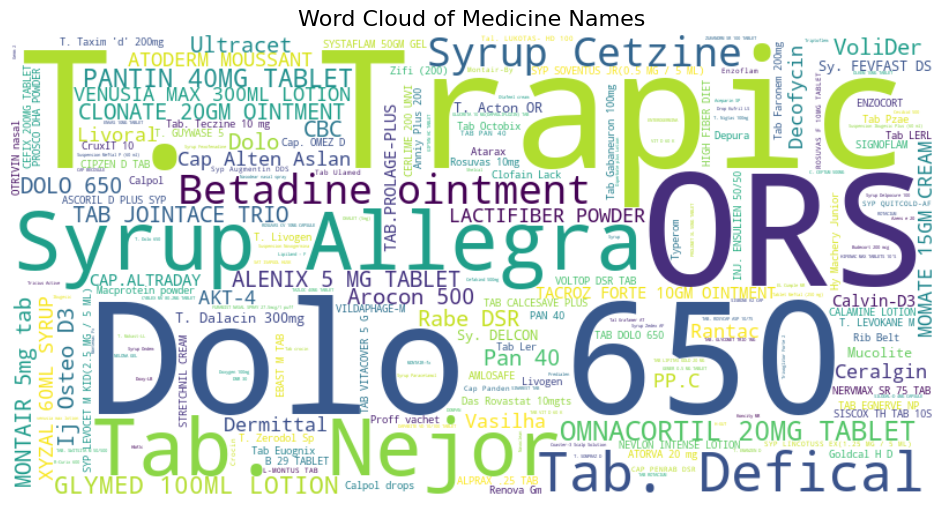

In [13]:
medicine_names = [name for row in rows_with_med for name in row.get("medicine_names", [])]
wordcloud = WordCloud(width=800, height=400, background_color="white").generate_from_frequencies(medicine_counter)
plt.figure(figsize=(12, 6))
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title("Word Cloud of Medicine Names", fontsize=16)
plt.show()

#### **Dataset**2: Drop all invalid rows (Full Medicine Details)

In [14]:
dictionized_dataset[0]['medicine_details']

[{'medicine_name': 'Cap Pregabalin',
  'medicine_dosage': '1-0-1',
  'medicine_frequency': 'Before breakfast and dinner',
  'course_duration': '1 week'},
 {'medicine_name': 'Etoshivic 90mg',
  'medicine_dosage': '1-0-0',
  'medicine_frequency': 'Before breakfast',
  'course_duration': '1 month'},
 {'medicine_name': 'Lyse',
  'medicine_dosage': '1-0-0',
  'medicine_frequency': 'Before breakfast',
  'course_duration': '1 month'}]

In [15]:
rows_with_med_full_detail = []
for row in dictionized_dataset:
    if 'medicine_details' in row['results']:
        medicine_details = row['results']['medicine_details']
        if len(medicine_details) > 0:
            row['medicine_details'] = row['results']['medicine_details']
            row['medicine_names'] = [medicine['medicine_name'] for medicine in medicine_details 
                                     if 'medicine_name' in medicine and medicine['medicine_name'] != 'NA' and medicine['medicine_name'] in row['text']]
            row['medicine_dosage'] = [medicine['medicine_dosage'] for medicine in medicine_details 
                                     if 'medicine_dosage' in medicine and medicine['medicine_dosage'] != 'NA' and medicine['medicine_dosage'] in row['text']]
            row['medicine_frequency'] = [medicine['medicine_frequency'] for medicine in medicine_details 
                                     if 'medicine_frequency' in medicine and medicine['medicine_frequency'] != 'NA' and medicine['medicine_frequency'] in row['text']]
            row['course_duration'] = [medicine['course_duration'] for medicine in medicine_details 
                                     if 'course_duration' in medicine and medicine['course_duration'] != 'NA' and medicine['course_duration'] in row['text']]
            rows_with_med_full_detail.append({'text': row['text'], 
                                  'medicine_details': row['medicine_details'], 
                                  'medicine_names': row['medicine_names'], 
                                  'medicine_dosage': row['medicine_dosage'], 
                                  'medicine_frequency': row["medicine_frequency"], 
                                  'course_duration': row['course_duration']})

In [16]:
len(rows_with_med_full_detail)

12648

#### **Dataset 3**: Correct Typos in Medicine Name

We see that the above data cleaning operations resulted in a loss in datasizes. After a closer inspection, we see that this is due to the fact that many medicine names are written with typo inside the original prescription, as shown in the following

In [18]:
dictionized_dataset[0]['results']['medicine_details'][0]['medicine_name']

'Cap Pregabalin'

In [21]:
print(dictionized_dataset[0]['text'])

      Balaji
                                                                                 GYNAE & NEURO CLINIC




                                                              MAX                   vDr. Rajesh Gupta
Dr. Ritu Gupta                                                                        MD (Medicine), DM (Neurology)
                                                              Healthcare
MBBS, MS (OBS & Gynae)                                                                Associate Director Neurology
  ior Consultant Gynaecologist                                                        Max Hospital, Patparganj & Vaishali
    Hospital, Vaishali & Paras Hospital, Vaishali                                     DMC : 8093 | Ph. : 9810541473
      15941                                                                           Sharad Vihar Clinic : 6:00 pm - 9:00 pm (Mon. to Fri.)
    ali Clinic : 11:00 am - 1:00 pm (Mon. to Sun.)                                    Vaishali C

In [22]:
print(dictionized_dataset[0]['results']['medicine_details'][0]['medicine_name'] in dictionized_dataset[0]['text'])

False


Notice that in the example above, the medicine "Cap Pregabalin" was written as "cap pregaind" in the original prescription. 

Hence, in this dataset, we attempt to correct these typos with so that we can use them for tagging and training later on.

In [23]:
rows_with_med_corr = []
for row in dictionized_dataset:
    if 'medicine_details' in row['results']:
        medicine_details = row['results']['medicine_details']
        if len(medicine_details) > 0:
            row['medicine_details'] = row['results']['medicine_details']
            row['medicine_names'] = [medicine['medicine_name'] for medicine in medicine_details 
                                     if 'medicine_name' in medicine and medicine['medicine_name'] != 'NA']
            rows_with_med_corr.append({'text': row['text'], 'medicine_details': row['medicine_details'], 'medicine_names': row['medicine_names']})

In [24]:
check = False
count = 0
total_count = 0
for row in rows_with_med_corr:
    for medicine in row['medicine_names']:
        if medicine not in row['text']:
            check = True
            count += 1
        total_count += 1
print(f"{check}, there are {count} typos with medicine name. There are {total_count} in total.")
    

True, there are 17037 typos with medicine name. There are 45458 in total.


Our chosen approach for correcting miswritten medicine names in prescriptions is based on the **Levenshtein distance**. The steps are as follows:

- **Splitting into k-grams**:  
  We first split the original prescription text into overlapping **k-grams**, where \( k \) corresponds to the number of words in the target medicine name. This ensures we evaluate each potential substring of the prescription text for a possible match.

- **Calculating Levenshtein Distance**:  
  For each \( k \)-gram, we compute the **Levenshtein distance** to determine how closely it resembles the target medicine name. This metric captures the minimum number of single-character edits (insertions, deletions, or substitutions) required to transform one string into another.

- **Selecting the Best Candidate**:  
  Among all the \( k \)-grams, we identify the candidate with the highest similarity score. If the score exceeds a predefined cutoff (e.g., 80), this candidate is deemed a close enough match to the target medicine name.

- **Replacing with the Correct Name**:  
  The identified candidate is then replaced with the correct medicine name in the prescription text.

We use the `fuzzywuzzy` library, which provides an intuitive and efficient implementation for calculating Levenshtein distance and similarity scores.


In [25]:
def correct_typos(text: str, known_names: List[str]) -> str:
    """
    Corrects typos in the text using fuzzy matching with a known list of medicine names.
    """
    n = len(known_names[0].split()) if known_names else 1
    words = text.split()
    best_match = None
    best_score = 0
    best_ngram = None
    text_ngrams = list(ngrams(words, n))
    text_ngrams = [' '.join(ngram).strip() for ngram in text_ngrams if ' '.join(ngram).strip()]
    for ngram in text_ngrams:
        if ngram:
            match, score = process.extractOne(ngram, known_names)
            if score > best_score:
                best_score = score
                best_match = match
                best_ngram = ngram
    if best_score > 80:
        corrected_text = text.replace(best_ngram, best_match)
    else:
        corrected_text = text
    return corrected_text

In [45]:
for row in rows_with_med_corr:
  text = row['text']
  medicine_names = row['medicine_names']
  for i, medicine_name in enumerate(medicine_names):
    if medicine_name not in text:
      row['text'] = correct_typos(text, [medicine_name])
dataset = {'dataset': rows_with_med_corr}
filename = 'corrected_dataset.json'
with open(filename, 'w') as f:
  json.dump(dataset, f)

Let's examine the cleaned dataset

In [17]:
with open('corrected_dataset.json', 'r') as file:
    data = json.load(file)
dataset = data['dataset']

In [18]:
dataset[0]['text']

'      Balaji\n                                                                                 GYNAE & NEURO CLINIC\n\n\n\n\n                                                              MAX                   vDr. Rajesh Gupta\nDr. Ritu Gupta                                                                        MD (Medicine), DM (Neurology)\n                                                              Healthcare\nMBBS, MS (OBS & Gynae)                                                                Associate Director Neurology\n  ior Consultant Gynaecologist                                                        Max Hospital, Patparganj & Vaishali\n    Hospital, Vaishali & Paras Hospital, Vaishali                                     DMC : 8093 | Ph. : 9810541473\n      15941                                                                           Sharad Vihar Clinic : 6:00 pm - 9:00 pm (Mon. to Fri.)\n    ali Clinic : 11:00 am - 1:00 pm (Mon. to Sun.)                                

In [19]:
dataset[0]['medicine_names'][0]

'Cap Pregabalin'

In [20]:
print(dataset[0]['medicine_names'][0] in dataset[0]['text'])

True


### Next, we will need to perform text cleaning to all three datasets to remove unnecessary informations inside the raw text (original prescription)

In [21]:
def clean_text(text: str) -> str:
    # Remove doctor signatures
    text = re.sub(r'Dr\.\s+\w+\s+\w+', '', text)
    # Remove phone numbers
    text = re.sub(r'\d{10}', '', text)
    # Remove email addresses
    text = re.sub(r'info@[\w\.]+', '', text)
    # Remove website URLs
    text = re.sub(r'www\.[\w\.]+', '', text)
    # Remove extra whitespaces and newlines
    text = re.sub(r'\s+', ' ', text)
    return text.strip().lower()

In [22]:
for row in rows_with_med:
    row['text'] = clean_text(row['text'])
for row in rows_with_med_full_detail:
    row['text'] = clean_text(row['text'])
rows_with_med_corr = dataset
for row in rows_with_med_corr:
    row['text'] = clean_text(row['text'])

In [26]:
print(rows_with_med_corr[0]['text'])

balaji gynae & neuro clinic max v md (medicine), dm (neurology) healthcare mbbs, ms (obs & gynae) associate director neurology ior consultant gynaecologist max hospital, patparganj & vaishali hospital, vaishali & paras hospital, vaishali dmc : 8093 | ph. : 15941 sharad vihar clinic : 6:00 pm - 9:00 pm (mon. to fri.) ali clinic : 11:00 am - 1:00 pm (mon. to sun.) vaishali clinic : 11:00 am - 1:00 pm (sun.) d vihar : by appointment for appointment : appointment : ph. : date 22/3/23 mrs neelofer age /sex 29/f nev. reported grade 3 av pari now mainly archiunal w deficit cap pregabalin me ff × 1 week -1 x b.auyan < p bd bir - 1 etoshivic 90mg my 10g t lyse bring graphy 1 month carpal tunnel 1pling vaishali clinic : plot no. 319, sharad vihar clinic : 5, sharad vihar, delhi-92 o sector 3a, pnb road, vaishali (near karkardooma metro station)


### Step 2: Tagging the entities.

1. **B - Begin**:
   - Indicates that the token is the beginning of a named entity.
   - **Example**: In `["B-MEDICINE_NAME"]`, the token is the start of a medicine name entity.

2. **I - Inside**:
   - Indicates that the token is inside a named entity.
   - **Example**: In `["I-MEDICINE_NAME"]`, the token is part of the same medicine name entity.

3. **O - Outside**:
   - Indicates that the token does not belong to any named entity.
   - **Example**: `["O"]` is used for tokens like stopwords or non-entity words.


In [27]:
def tagging_entities(text_corrected: str, entities: List[Dict[str, str]]) -> List[str]:
    """
    Tags entities in the text using BIO tagging for multiple entity types.

    Args:
        text_corrected (str): The cleaned and typo-corrected text.
        entities (List[Dict[str, str]]): A list of dictionaries containing 'label' and 'text' for each entity.

    Returns:
        List[str]: A list of BIO tags corresponding to each token in the text.
    """
    tokens = text_corrected.split()
    BIO = ["O"] * len(tokens)

    for entity in entities:
        label = entity['label']
        entity_text = entity['text']
        pattern = re.compile(r'\b' + re.escape(entity_text) + r'\b', re.IGNORECASE)

        for match in pattern.finditer(text_corrected):
            start_char, end_char = match.start(), match.end()
            current_pos = 0
            for idx, token in enumerate(tokens):
                token_start = text_corrected.find(token, current_pos)
                if token_start == -1:
                    continue
                token_end = token_start + len(token)
                current_pos = token_end
                if token_start >= start_char and token_end <= end_char:
                    if token_start == start_char:
                        BIO[idx] = f'B-{label}'
                    else:
                        BIO[idx] = f'I-{label}'
    return BIO

In [28]:
for row in rows_with_med:
    entities = []
    for medicine_name in row["medicine_names"]:
        entities.append({"label": "MEDICINE_NAME", "text": medicine_name})
    row["BIO"] = tagging_entities(row["text"], entities)
for row in rows_with_med_full_detail:
    entities = []
    for name in row['medicine_names']:
        entities.append({'label': 'MEDICINE_NAME', 'text': name.lower()})
    for dosage in row['medicine_dosage']:
        entities.append({'label': 'MEDICINE_DOSAGE', 'text': dosage.lower()})
    for frequency in row['medicine_frequency']:
        entities.append({'label': 'MEDICINE_FREQUENCY', 'text': frequency.lower()})
    for duration in row['course_duration']:
        entities.append({'label': 'COURSE_DURATION', 'text': duration.lower()})
    row["BIO"] = tagging_entities(row["text"], entities)
for row in rows_with_med_corr:
    entities = []
    for medicine_name in row["medicine_names"]:
        entities.append({"label": "MEDICINE_NAME", "text": medicine_name})
    row["BIO"] = tagging_entities(row["text"], entities)

In [29]:
rows_with_med[2]['BIO']

['O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'B-MEDICINE_NAME',
 'I-MEDICINE_NAME',
 'I-MEDICINE_NAME',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O']

In [30]:
rows_with_med_full_detail[2]["BIO"]

['O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'B-MEDICINE_DOSAGE',
 'O',
 'B-MEDICINE_NAME',
 'I-MEDICINE_NAME',
 'I-MEDICINE_NAME',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O']

In [31]:
rows_with_med_corr[2]['BIO']

['O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'B-MEDICINE_NAME',
 'I-MEDICINE_NAME',
 'I-MEDICINE_NAME',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O',
 'O']

In [32]:
dataset1 = Dataset.from_list(rows_with_med)
dataset2 = Dataset.from_list(rows_with_med_full_detail)
dataset3 = Dataset.from_list(rows_with_med_corr)

In [33]:
dataset1

Dataset({
    features: ['text', 'medicine_details', 'medicine_names', 'BIO'],
    num_rows: 12648
})

In [34]:
dataset2

Dataset({
    features: ['text', 'medicine_details', 'medicine_names', 'medicine_dosage', 'medicine_frequency', 'course_duration', 'BIO'],
    num_rows: 12648
})

In [35]:
dataset3

Dataset({
    features: ['text', 'medicine_details', 'medicine_names', 'BIO'],
    num_rows: 12648
})

### Step 3: Tokenize the datset for training.

In [36]:
def tokenize_and_align_labels(examples, tokenizer, label_list):
    # Tokenize input text
    tokenized_inputs = tokenizer(
        examples["text"],
        truncation=True,
        padding="max_length",
        max_length=512,
        return_offsets_mapping=True  # Return offsets to map labels to tokens
    )

    labels = []
    for i, bio_tags in enumerate(examples["BIO"]):  # Iterate over each example's BIO tags
        offset_mapping = tokenized_inputs["offset_mapping"][i]
        label_ids = []
        word_idx = 0  # Keep track of the word index in BIO tags
        for idx, (start, end) in enumerate(offset_mapping):
            if start == 0 and end == 0:  # Special tokens like [CLS] and [SEP]
                label_ids.append(-100)
            else:
                # Assign the label for the current token
                if start == 0 or (idx > 0 and offset_mapping[idx - 1][1] == start):
                    # Assign the current word's label (BIO tag)
                    if word_idx < len(bio_tags):
                        label = bio_tags[word_idx]
                        word_idx += 1
                    else:
                        label = "O"
                else:
                    # For subword tokens, inherit the `I-` label
                    if label.startswith("B-"):
                        label = label.replace("B-", "I-")
                label_id = label_list.index(label) if label in label_list else label_list.index("O")
                label_ids.append(label_id)

        labels.append(label_ids)

    # Add aligned labels to tokenized dataset
    tokenized_inputs["labels"] = labels
    return tokenized_inputs

In [37]:
tokenizer = AutoTokenizer.from_pretrained("bert-base-uncased")

label_list = [
    "O",
    "B-MEDICINE_NAME",
    "I-MEDICINE_NAME",
    "B-MEDICINE_DOSAGE",
    "I-MEDICINE_DOSAGE",
    "B-MEDICINE_FREQUENCY",
    "I-MEDICINE_FREQUENCY",
    "B-COURSE_DURATION",
    "I-COURSE_DURATION"
]
tokenized_dataset1 = dataset1.map(
    tokenize_and_align_labels,
    batched=True,
    remove_columns=["text", "BIO", "medicine_details", "medicine_names"],
    fn_kwargs={"tokenizer": tokenizer, "label_list": label_list}
)
tokenized_dataset2 = dataset2.map(
    tokenize_and_align_labels,
    batched=True,
    remove_columns=["text", "BIO", "medicine_details", "medicine_names", 'medicine_dosage', 'medicine_frequency', 'course_duration'],
    fn_kwargs={"tokenizer": tokenizer, "label_list": label_list}
)
tokenized_dataset3 = dataset3.map(
    tokenize_and_align_labels,
    batched=True,
    remove_columns=["text", "BIO", "medicine_details", "medicine_names"],
    fn_kwargs={"tokenizer": tokenizer, "label_list": label_list}
)

Map:   0%|          | 0/12648 [00:00<?, ? examples/s]

Map:   0%|          | 0/12648 [00:00<?, ? examples/s]

Map:   0%|          | 0/12648 [00:00<?, ? examples/s]

In [39]:
tokenized_dataset1.save_to_disk("dataset1_512")
tokenized_dataset2.save_to_disk("dataset2_512")
tokenized_dataset3.save_to_disk("dataset3_512")

Saving the dataset (0/1 shards):   0%|          | 0/12648 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/12648 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/12648 [00:00<?, ? examples/s]